Goal: identify the best performing covariance model (model that takes this period's features and this periods home value)

In [1]:
import pandas as pd
import numpy as np
%matplotlib inline
import matplotlib.pyplot as pl
import datetime
import pickle
import seaborn as sns

from fancyimpute import KNN
from scipy import stats

import statsmodels.formula.api as smf  

from sklearn.metrics import r2_score

from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor
from sklearn.datasets import make_classification
from sklearn.ensemble import ExtraTreesClassifier

from sklearn.linear_model import RandomizedLasso
from sklearn.metrics import median_absolute_error
from sklearn.linear_model import LinearRegression

from sklearn.linear_model import ElasticNet
import time

from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import GradientBoostingRegressor

In [2]:
def drop_columns(df,phrase,dropped_cols=False):
    '''Drop all columns in dataframe df that contain substring phrase'''
    start_len = len(df.columns)
    drop_cols = []
    for i in df.columns:
        if phrase in i:
            drop_cols.append(i)
            df.drop([i], axis=1, inplace=True)
    #print ('Total Columns Dropped: {}'.format(len(drop_cols)))
    if dropped_cols == True:
        print ('Dropped Columns: {}'.format(drop_cols))

In [3]:
def column_filter(df,phrase):
    '''produces a list of columns that contain the phrase'''
    start_len = len(df.columns)
    keep_cols = []
    for i in df.columns:
        if phrase in i:
            keep_cols.append(i)
    #print ('Columns matching filter: {}'.format(len(keep_cols)))
    return (keep_cols)

In [167]:
def mdl_eval(mdl, output, regressors, test, train, color, show=True):
    ''' For a specific model, produce the in sample R square value, the out of sample r sqaure, 
        and the median absolute error. Returns the Radj and Median Absolute Error '''
    
    Rout = r2_score(test[output], mdl.predict(test[regressors]))
    R = Rout
    p = len(regressors)
    n = len(test)
    Radj = R - ((1 - R)*((p)/(n-p-1)))
    model_score = median_absolute_error(test[output], mdl.predict(test[regressors]))
    

    
    if show == True:
        
        print ('In Sample RSquared: ', mdl.score(train[regressors], train[output]))
        print ('Out of sample R-Squared: ', Rout)
        print ('Out of sample Adjusted R-Squared: ', Radj)
        print ('Model Eval (Median Absolute Error): ', model_score)
        
        pl.figure(figsize=(8,6))
        pl.title("Radj = {}, p = {}".format(Radj, p), fontsize=16)
        pl.plot(test[output], mdl.predict(test[regressors]), 'o', alpha=.5, c=color)
        pl.plot(test[output], test[output])
        pl.xlabel('Observed Values', fontsize=14)
        pl.ylabel('Predicted Values', fontsize=14)
    
    return (Radj, model_score)

In [400]:
def feat_sel(df, output, features, model='rf', alpha=100, feat_num=20):
    '''
    performs random forest or lasso fit on specified dataframe and produces a list of 
    the top specified number of features and returns a sorted list of the features and their scores.
    '''
    regressors = features
    #regressors = list(set(df.columns) - set([output]))

    y = df[output]
    X = df[regressors] #select all the columns after id and geography -- the regressors
    names = X.columns

    rlasso = RandomizedLasso(alpha=alpha,random_state=0, normalize=True, fit_intercept=True)
    rlasso.fit(X, y)

    rf = RandomForestRegressor(random_state=0,n_estimators=100)
    rf.fit(X, y)

    if model == 'lasso':
        feat_sort = (sorted(zip(map(lambda x: round(x, 10), rlasso.scores_), names), reverse=True))
    else: 
        feat_sort = (sorted(zip(map(lambda x: round(x, 4), rf.feature_importances_), names), reverse=True))
        print ('R-Score', rf.score(X, y))

    pl.figure(figsize=(8,6))
    pl.title("{} Feature importance".format(model))
    pl.bar(np.arange(feat_num), pd.DataFrame(feat_sort)[0][:feat_num], align='center')
    pl.xticks(np.arange(feat_num), fontsize=8)
    pl.ylabel('Importance Score')

    print("{} Feature ranking:".format(model), pd.DataFrame(feat_sort)[:5])
    return feat_sort

In [359]:
home_value_indicators = ['Med_Listing_Price_Sfr','ZHVI_SingleFamilyResidence',
                         'Med_Listing_Price_AllHomes', 
                         'ZHVI_AllHomes', 'County_MedianValuePerSqft_AllHomes']

In [360]:
zillow_feats = [word+'_next' for word in home_value_indicators] + [word+'_current' for word in home_value_indicators]

In [361]:
#set output variable
output = 'ZHVI_AllHomes_current'

## 1. Load dataset

In [362]:
path = './data/dataframes/all_feats.csv'
data = pd.read_csv(path)
data['FIPS'] = data.FIPS.apply(str)
data['FIPS'] = data.FIPS.str.zfill(5)
data.drop(['Unnamed: 0'], axis=1, inplace=True)
print('Cols: ', len(data.columns), 'Rows: ', len(data))
drop_columns(data, '_y')
print('Cols, after dropping doubles: ', len(data.columns), 'Rows: ', len(data))
data.head()

Cols:  1741 Rows:  3872
Cols, after dropping doubles:  1433 Rows:  3872


,FIPS,County_MedianValuePerSqft_AllHomes_current,County_PctOfHomesDecreasingInValues_AllHomes,County_PriceToRentRatio_AllHomes,DaysOnZillow_Public_County,InventoryMeasure_County_Public,InventoryMeasure_SSA_County_Public,Med_Listing_Price_1bedroom,Med_Listing_Price_2bedroom,Med_Listing_Price_3bedroom,...,Percent__YEAR_STRUCTURE_BUILT__Built_2005_or_later,Percent__YEAR_STRUCTURE_BUILT__Built_2005_or_later_log,Percent__YEAR_STRUCTURE_BUILT__Built__or_later,Percent__YEAR_STRUCTURE_BUILT__Built__or_later_log,Percent__YEAR_STRUCTURE_BUILT__Built__to_,Percent__YEAR_STRUCTURE_BUILT__Built__to__log,Percent__YEAR_STRUCTURE_BUILT__Total_housing_units,Percent__YEAR_STRUCTURE_BUILT__Total_housing_units_log,housing_density,housing_density_log
0,01003,88.583333,45.237500,11.416667,158.458333,4486.000000,4485.250000,NaN,202900.0,204583.333333,...,17.1,2.839078,NaN,NaN,NaN,NaN,104704.0,11.558893,60.476680,4.102258
1,01015,NaN,NaN,NaN,NaN,945.083333,946.166667,NaN,NaN,113773.333333,...,3.5,1.252763,NaN,NaN,NaN,NaN,53357.0,10.884760,85.873717,4.452878
2,01043,65.666667,40.880000,10.665000,NaN,783.833333,785.583333,NaN,NaN,128520.833333,...,7.8,2.054124,NaN,NaN,NaN,NaN,37118.0,10.521857,48.525205,3.882083
3,01051,NaN,NaN,NaN,NaN,592.833333,593.166667,NaN,NaN,155109.583333,...,16.6,2.809403,NaN,NaN,NaN,NaN,33240.0,10.411509,49.593739,3.903865
4,01055,46.583333,58.411667,8.283333,NaN,855.333333,855.333333,NaN,NaN,118470.833333,...,6.1,1.808289,NaN,NaN,NaN,NaN,47353.0,10.765385,85.138866,4.444284


In [363]:
#factorize state data
data['STATE'] = (pd.factorize(data.STATE))[0]

## 1b. drop features that are too closely associated with home value

In [364]:
zillow_feats.remove(output)

In [365]:
data.drop(zillow_feats, axis=1, inplace=True)

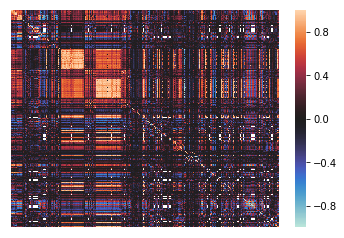

In [367]:
corr = data.corr()
sns.heatmap(corr, center=0,
        xticklabels=False,
        yticklabels=False)

In [368]:
mask = list(corr.loc[output] > .85)
corr_feats = list(corr.columns[mask])
len(corr_feats)

22

In [369]:
corr_feats

['Med_Listing_Price_2bedroom',
 'Med_Listing_Price_DuplexTriplex',
 'ZHVI_AllHomes_current',
 'med_rental_1bedroom',
 'med_rental_2bedroom',
 'med_rental_3bedroom',
 'med_rental_AllHomes',
 'med_rental_CondoCoop',
 'med_rental_DuplexTriplex',
 'med_rental_Mfr5Plus',
 'med_rental_Sfr',
 'rent_price_persqft_1bedroom',
 'rent_price_persqft_2bedroom',
 'rent_price_persqft_DuplexTriplex',
 'rent_price_persqft_Mfr5Plus',
 'Estimate__SELECTED_MONTHLY_OWNER_COSTS_SMOC__Median_dollars',
 'Estimate__VALUE__Median_dollars',
 'Estimate__VALUE__Median_dollars_log',
 'Percent__GROSS_RENT__1500_or_more',
 'Percent__SELECTED_MONTHLY_OWNER_COSTS_SMOC__2000_or_more',
 'Percent__SELECTED_MONTHLY_OWNER_COSTS_SMOC__3000_or_more',
 'Percent__VALUE__500000_to_999999']

In [370]:
corr_feats.remove(output)

In [371]:
data.drop(corr_feats, axis=1, inplace=True)

In [372]:
#Check row and column length
print ('cols: ', len(data.columns), 'rows: ', len(data))

cols:  1403 rows:  3872


In [373]:
column_filter(data, 'VALUE')

['Percent__VALUE__1000000_or_more',
 'Percent__VALUE__1000000_or_more_log',
 'Percent__VALUE__100000_to_149999',
 'Percent__VALUE__100000_to_149999_log',
 'Percent__VALUE__150000_to_199999',
 'Percent__VALUE__150000_to_199999_log',
 'Percent__VALUE__200000_to_299999',
 'Percent__VALUE__200000_to_299999_log',
 'Percent__VALUE__300000_to_499999',
 'Percent__VALUE__300000_to_499999_log',
 'Percent__VALUE__500000_to_999999_log',
 'Percent__VALUE__50000_to_99999',
 'Percent__VALUE__50000_to_99999_log',
 'Percent__VALUE__Less_than_50000',
 'Percent__VALUE__Less_than_50000_log',
 'Percent__VALUE__Owneroccupied_units',
 'Percent__VALUE__Owneroccupied_units_log']

In [374]:
data.drop(column_filter(data, 'VALUE'), axis=1, inplace=True)
#Check row and column length
print ('cols: ', len(data.columns), 'rows: ', len(data))

cols:  1386 rows:  3872


In [375]:
data.drop(column_filter(data, '_next'), axis=1, inplace=True)
#Check row and column length
print ('cols: ', len(data.columns), 'rows: ', len(data))

cols:  1386 rows:  3872


## 2. Impute or drop nans

** * drop rows where we don't have home values * **

In [376]:
data.dropna(how='any', subset=[output], inplace=True)
#Check row and column length
print ('cols: ', len(data.columns), 'rows: ', len(data))

cols:  1386 rows:  3494


** * drop columns with Nans * **

In [211]:
data_drp = data.dropna(axis=1, how='any')
#Check row and column length
print ('cols: ', len(data_drp.columns), 'rows: ', len(data_drp))

cols:  677 rows:  3494


** * Fill NaNs with Mean * **

In [212]:
data_mn = data.fillna(value=data.mean())
#Check row and column length
print ('cols: ', len(data_mn.columns), 'rows: ', len(data_mn))

cols:  1403 rows:  3494


** * Fill NaNs with 3 nearest Neighbors * **

In [377]:
data_labels = data[['FIPS', 'STATE', 'COUNTYNAME']]

In [378]:
data_data = data.drop(['FIPS', 'STATE', 'COUNTYNAME'], axis=1)
col_names = data_data.columns
data_data = KNN(k=3).complete(data_data)
data_data = pd.DataFrame(data_data)
data_data.columns = col_names
data_knn = pd.merge(data_labels, data_data, left_index=True, right_index=True)

Imputing row 1/3494 with 427 missing, elapsed time: 118.940
Imputing row 101/3494 with 444 missing, elapsed time: 120.615
Imputing row 201/3494 with 431 missing, elapsed time: 122.150
Imputing row 301/3494 with 434 missing, elapsed time: 123.691
Imputing row 401/3494 with 434 missing, elapsed time: 125.218
Imputing row 501/3494 with 437 missing, elapsed time: 126.697
Imputing row 601/3494 with 426 missing, elapsed time: 128.204
Imputing row 701/3494 with 420 missing, elapsed time: 129.661
Imputing row 801/3494 with 423 missing, elapsed time: 131.035
Imputing row 901/3494 with 443 missing, elapsed time: 132.504
Imputing row 1001/3494 with 437 missing, elapsed time: 133.977
Imputing row 1101/3494 with 434 missing, elapsed time: 135.612
Imputing row 1201/3494 with 417 missing, elapsed time: 137.455
Imputing row 1301/3494 with 421 missing, elapsed time: 139.152
Imputing row 1401/3494 with 364 missing, elapsed time: 140.904
Imputing row 1501/3494 with 356 missing, elapsed time: 142.262
Impu

In [379]:
#Check row and column length
print ('cols: ', len(data_knn.columns), 'rows: ', len(data_knn))

cols:  1386 rows:  3165


## 3. Create Training, Validation, and Test Datasets

### a. Select which dataset to use:

#### Dropped Nans

In [40]:
df = data_drp

#### Mean Filled

In [204]:
df = data_mn

#### KNN Imputed

In [380]:
df = data_knn

### b. Training, Validation, Test data

In [381]:
df.drop(column_filter(df, '_next'), axis=1, inplace=True)
#Check row and column length
print ('cols: ', len(df.columns), 'rows: ', len(df))

cols:  1386 rows:  3165


In [382]:
features = list(set(df.columns) - set(['FIPS', 'COUNTYNAME', output] + zillow_feats))

In [383]:
train = df[df.YEAR <= 2014]
test1 = df[df.YEAR <= 2015]
test2 = df[df.YEAR <= 2016]

Create a subsample of 20% of data to train covariance model. Use model to predict for the rest of the 80% of data and the next year's data.

/Users/baileygriswold/anaconda3/lib/python3.6/site-packages/matplotlib/pyplot.py:524: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


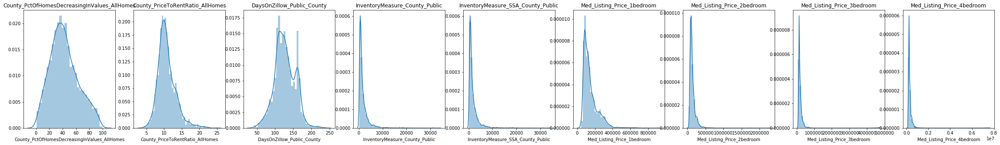

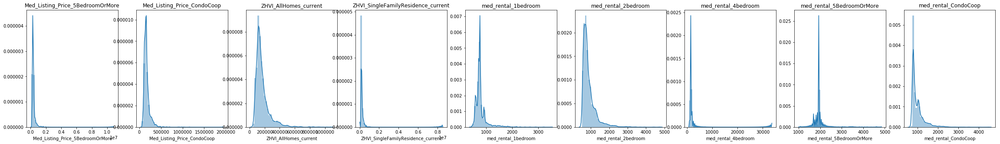

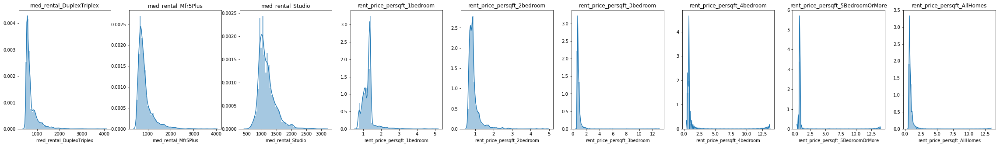

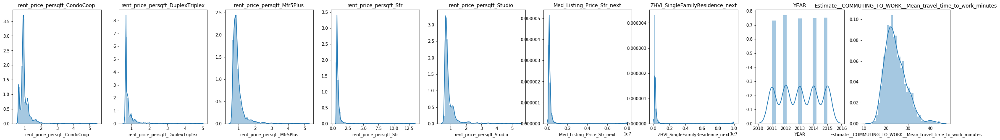

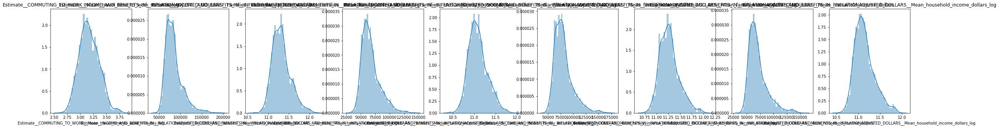

...

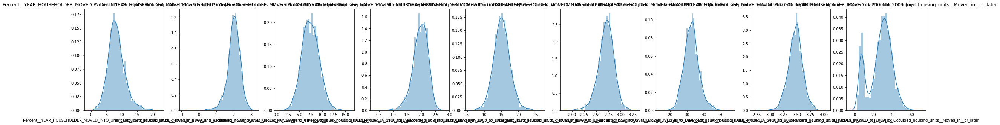

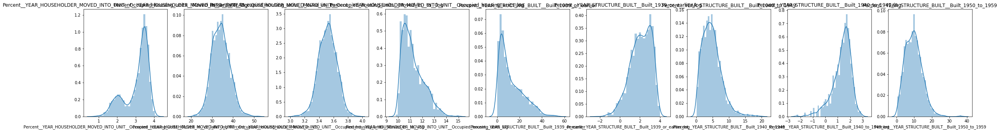

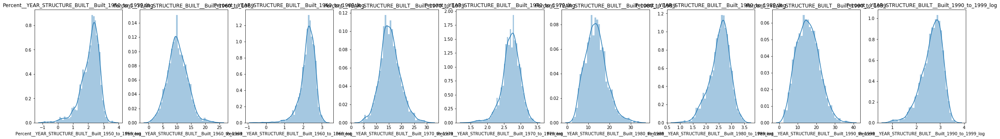

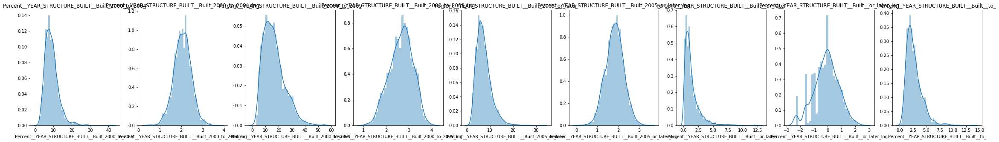

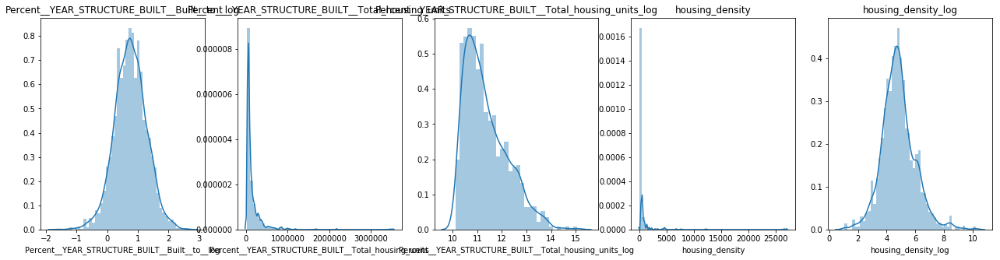

In [145]:
counter = 0
for i in df.columns[3:(len(df.columns))]:
        level =  ((counter+9)// 9)
        pl.figure(level,figsize=(40,5))                
        pl.subplot(190+((counter - (9* (level-1)) + 1))) 
        try: 
            sns.distplot(df[i])
           # pl.plot(df[i], df['ZHVI_AllHomes_current'], '.')
        #pl.xscale('log')
        #pl.ylabel('ZHVI, 2011')
        #pl.xlabel(i)
        except [ValueError, TypeError]:
            pass
        #pl.xscale('log')
        pl.title(i, fontsize=12)
        counter += 1

In [384]:
x_train, x_test, y_train, y_test = train_test_split(df[features],df[output], train_size=.2, random_state=0, stratify=df.STATE)

/Users/baileygriswold/anaconda3/lib/python3.6/site-packages/sklearn/model_selection/_split.py:2010: FutureWarning: From version 0.21, test_size will always complement train_size unless both are specified.
  FutureWarning)


In [385]:
train = pd.concat([x_train, y_train], axis=1)

In [386]:
val =pd.concat([x_test, y_test], axis=1)

## 4. Create an OLS Baseline Model

In [414]:
mdl_res = [(0, 0)]
res_labels = ['Model', 'Feature_sel', 'N_Features', 'Out_of_sample_data', 'R_Adj', 'MAE']

In Sample RSquared:  1.0
Out of sample R-Squared:  -0.0307648929913
Out of sample Adjusted R-Squared:  -1.27253131024
Model Eval (Median Absolute Error):  26514.835516


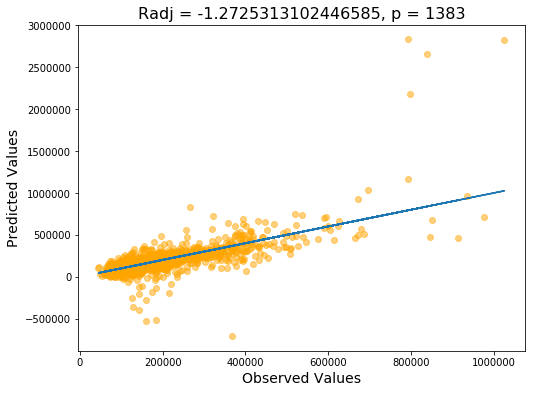

In [415]:
lm = LinearRegression()
lm.fit(x_train, y_train)
Radj, mae = mdl_eval(lm, output, features, val, train, 'orange')
mdl_res.append(('OLS', 'Baseline', len(features), 'val', Radj, mae))

A baseline OLS Model of all the features in the dataset predicting the Zillow Home Values. 205 of the data was used to train the model, and it was validated against the other 80%. The graph shows the performance of the model in predicting the home values for the 80% of the data not included in the training set. The values for each features are from the same year as the output home values.

In [416]:
Radj, mae = mdl_eval(lm, output, features, test1, train, 'orange', show=False)
mdl_res.append(('OLS', 'Baseline', len(features), '2015', Radj, mae))

Radj, mae = mdl_eval(lm, output, features, test2, train, 'orange', show=False)
mdl_res.append(('OLS', 'Baseline', len(features), '2016', Radj, mae))

## 5. Feature Selection

** * a. Correlation * **

In [390]:
corr = df.corr()

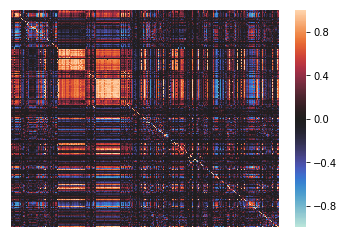

In [391]:
sns.heatmap(corr, center=0,
        xticklabels=False,
        yticklabels=False)

In [392]:
mask = list((df.corr().loc[output] > .5) & (df.corr().loc[output] <= .9))

In [393]:
corr_feats = list(df.corr().columns[mask])

In [394]:
len(corr_feats)

228

** * b. Random Forest * **

/Users/baileygriswold/anaconda3/lib/python3.6/site-packages/sklearn/utils/deprecation.py:57: DeprecationWarning: Class RandomizedLasso is deprecated; The class RandomizedLasso is deprecated in 0.19 and will be removed in 0.21.
  warnings.warn(msg, category=DeprecationWarning)


R-Score 0.988522529568
rf Feature ranking:         0                                                  1
0  0.4146                         Med_Listing_Price_3bedroom
1  0.1365  Estimate__SELECTED_MONTHLY_OWNER_COSTS_SMOC__M...
2  0.0756               Estimate__GROSS_RENT__Median_dollars
3  0.0529                   County_PriceToRentRatio_AllHomes
4  0.0453           Estimate__GROSS_RENT__Median_dollars_log


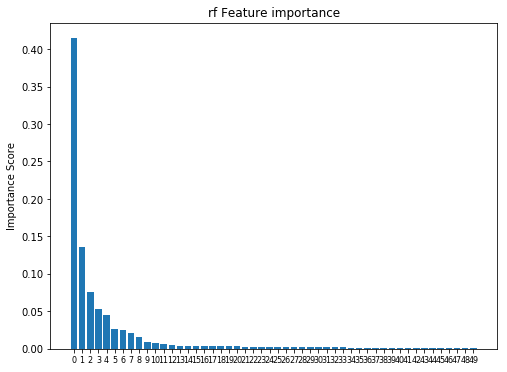

In [401]:
rf_res = pd.DataFrame(feat_sel(train, output, features, feat_num=50))

In [405]:
rf_feats = list(rf_res[1][:34])
rf_feats

In [406]:
rf_feats

['Med_Listing_Price_3bedroom',
 'Estimate__SELECTED_MONTHLY_OWNER_COSTS_SMOC__Median_dollars_log',
 'Estimate__GROSS_RENT__Median_dollars',
 'County_PriceToRentRatio_AllHomes',
 'Estimate__GROSS_RENT__Median_dollars_log',
 'Percent__SELECTED_MONTHLY_OWNER_COSTS_SMOC__1000_to_1499',
 'rent_price_persqft_AllHomes',
 'Percent__SELECTED_MONTHLY_OWNER_COSTS_SMOC__1000_to_1499_log',
 'Percent__SELECTED_MONTHLY_OWNER_COSTS_SMOC__700_to_999',
 'Percent__SELECTED_MONTHLY_OWNER_COSTS_SMOC__700_to_999_log',
 'rent_price_persqft_3bedroom',
 'rent_price_persqft_Sfr',
 'Percent__GROSS_RENT__2000_to_2499',
 'rent_price_persqft_Studio',
 'Percent__GROSS_RENT__1000_to_1499',
 'Percent__SELECTED_MONTHLY_OWNER_COSTS_SMOC__2000_or_more_log',
 'rent_price_persqft_5BedroomOrMore',
 '19300_log',
 'Med_Listing_Price_CondoCoop',
 '19700',
 'Percent__INCOME_AND_BENEFITS_IN__INFLATIONADJUSTED_DOLLARS__50000_to_74999',
 'Percent__GROSS_RENT__3000_or_more_log',
 'Percent__GROSS_RENT__2000_to_2499_log',
 'Percent__

** * c. LASSO * **

/Users/baileygriswold/anaconda3/lib/python3.6/site-packages/sklearn/utils/deprecation.py:57: DeprecationWarning: Class RandomizedLasso is deprecated; The class RandomizedLasso is deprecated in 0.19 and will be removed in 0.21.
  warnings.warn(msg, category=DeprecationWarning)


lasso Feature ranking:        0                                                  1
0  0.550                   County_PriceToRentRatio_AllHomes
1  0.515               Estimate__GROSS_RENT__Median_dollars
2  0.500  Estimate__SELECTED_MONTHLY_OWNER_COSTS_SMOC__M...
3  0.475                         Med_Listing_Price_3bedroom
4  0.400                             rent_price_persqft_Sfr


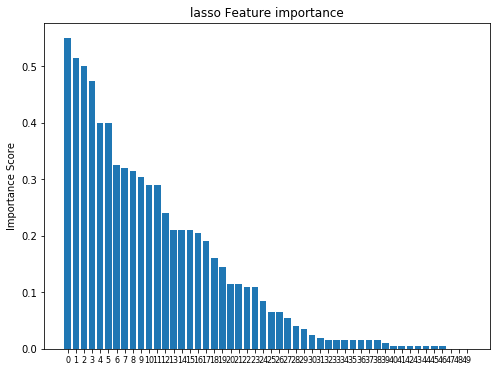

In [402]:
lasso_res = pd.DataFrame(feat_sel(train, output, features, model='lasso',alpha = 1000, feat_num=50))

In [404]:
las_feats = list(lasso_res[1][:47])
las_feats

['County_PriceToRentRatio_AllHomes',
 'Estimate__GROSS_RENT__Median_dollars',
 'Estimate__SELECTED_MONTHLY_OWNER_COSTS_SMOC__Median_dollars_log',
 'Med_Listing_Price_3bedroom',
 'rent_price_persqft_Sfr',
 'rent_price_persqft_3bedroom',
 'Estimate__INCOME_AND_BENEFITS_IN__INFLATIONADJUSTED_DOLLARS__Nonfamily_households__Mean_nonfamily_income_dollars',
 'rent_price_persqft_AllHomes',
 'Percent__GROSS_RENT__2000_to_2499',
 'Med_Listing_Price_4bedroom',
 'Percent__RACE__One_race__Asian',
 '19300',
 'Percent__GROSS_RENT__2500_to_2999',
 'Percent__SELECTED_MONTHLY_OWNER_COSTS_SMOC__700_to_999_log',
 'Med_Listing_Price_CondoCoop',
 'Estimate__GROSS_RENT__Median_dollars_log',
 '04470',
 'Med_Listing_Price_5BedroomOrMore',
 'Percent__SELECTED_MONTHLY_OWNER_COSTS_SMOC__1000_to_1499_log',
 'Percent__INCOME_AND_BENEFITS_IN__INFLATIONADJUSTED_DOLLARS__200000_or_more',
 'Percent__HISPANIC_OR_LATINO_AND_RACE__Not_Hispanic_or_Latino__Asian_alone',
 'Percent__GROSS_RENT__3000_or_more',
 'med_rental_4be

## 6. Modeling

### ** * a. OLS * **

** * i. Corr Features * **

In Sample RSquared:  0.988867453737
Out of sample R-Squared:  0.932502535569
Out of sample Adjusted R-Squared:  0.925820198665
Model Eval (Median Absolute Error):  10704.68128


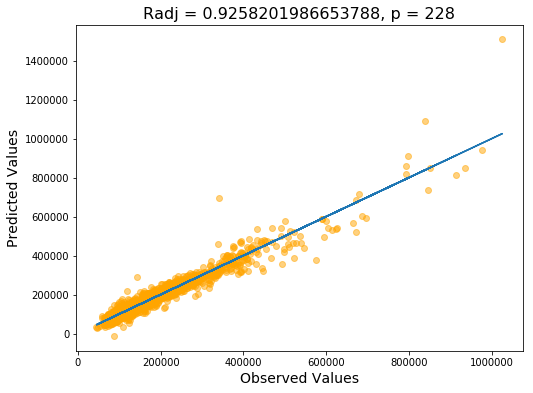

In [417]:
lm = LinearRegression()
lm.fit(train[corr_feats], train[output])
radj, mae = mdl_eval(lm, output, corr_feats, val, train, 'orange')
mdl_res.append(('OLS', 'Correlation', len(corr_feats), 'val', radj, mae))

Radj, mae = mdl_eval(lm, output, corr_feats, test1, train, 'orange', show=False)
mdl_res.append(('OLS', 'Correlation', len(features), '2015', Radj, mae))

Radj, mae = mdl_eval(lm, output, corr_feats, test2, train, 'orange', show=False)
mdl_res.append(('OLS', 'Correlation', len(features), '2016', Radj, mae))

OLS Model using features selected by correlation. Model performance assesd on predictions made on the out of sample data from 2010-2014.

** * ii. RF Features * **

In Sample RSquared:  0.97184900068
Out of sample R-Squared:  0.879543746601
Out of sample Adjusted R-Squared:  0.877903573347
Model Eval (Median Absolute Error):  10584.8813801


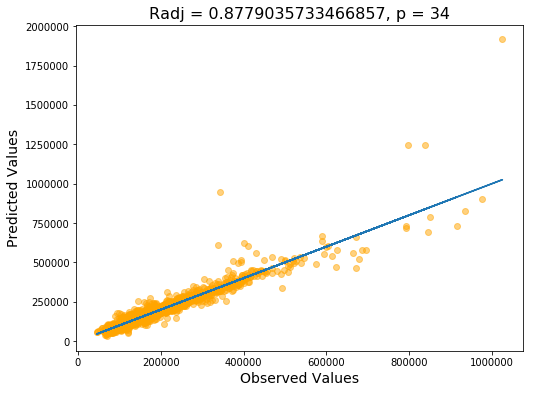

In [418]:
lm = LinearRegression()
lm.fit(train[rf_feats], train[output])
radj, mae = mdl_eval(lm, output, rf_feats, val, train, 'orange')
mdl_res.append(('OLS', 'Random Forest', len(rf_feats), 'val', radj, mae))

radj, mae = mdl_eval(lm, output, rf_feats, test1, train, 'orange', show=False)
mdl_res.append(('OLS', 'Random Forest', len(rf_feats), '2015', radj, mae))
radj, mae = mdl_eval(lm, output, rf_feats, test2, train, 'orange', show=False)
mdl_res.append(('OLS', 'Random Forest', len(rf_feats), '2016', radj, mae))

** * iii. LASSO Features * **

Linear Model on Lasso Selected Features 

In Sample RSquared:  0.976460487883
Out of sample R-Squared:  0.87487124008
Out of sample Adjusted R-Squared:  0.872503666925
Model Eval (Median Absolute Error):  10485.3808521


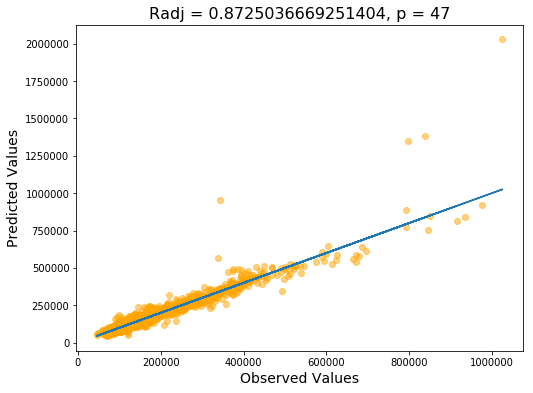

In [419]:
lm_l = LinearRegression()
lm_l.fit(train[las_feats],train[output])
print ('Linear Model on Lasso Selected Features', '\n')
Radj, mae = mdl_eval(lm_l, output, las_feats, val, train, 'orange')
mdl_res.append(('OLS', 'LASSO', len(las_feats), 'val', Radj, mae))

Radj, mae = mdl_eval(lm_l, output, las_feats, test1, train, 'orange', show=False)
mdl_res.append(('OLS', 'LASSO', len(las_feats), '2015', Radj, mae))
Radj, mae = mdl_eval(lm_l, output, las_feats, test2, train, 'orange', show=False)
mdl_res.append(('OLS', 'LASSO', len(las_feats), '2016', Radj, mae))

### ** * b. Random Forest * **

Determine correct parameters to use.

In [411]:
n_estimators=[10, 25, 100]
min_samples_leaf=[1, 5, 10]
min_samples_split=[2, 10, 20]
max_depth=[None, 5, 10]
max_leaf_nodes=[None, 5, 20]

In [412]:
labels = ['n_estimators', 'min_samples_leaf', 'min_samples_split', 'max_depth', 'max_leaf_nodes', 'outRadj', 'MAE']
a =[(0, 0, 0, 0,0)]

In [ ]:
starTime = time.time()
for e in n_estimators:
    for l in min_samples_leaf:
        for ss in min_samples_split:
            for d in max_depth:
                for no in max_leaf_nodes:
                    rf = RandomForestRegressor(random_state =42,
                                                n_estimators = e,
                                                min_samples_leaf = l,
                                                min_samples_split = ss,
                                                max_depth = d,
                                                max_leaf_nodes = no)
                    rf.fit(train[corr_feats], train[output])
                    r, mae = mdl_eval(rf, output, corr_feats, val, train, 'green', show=False)
                    a.append((e, l, ss, d, no, r, mae))
                    #print ('nest:{}, min_samp_lf:{}, min_sampspl:{}, max_d:{}, max_lfn:{}, AdjR:{}, MAE:{}'
                     #      .format(e, l, ss, d, no, r, mae))
print(time.time() - starTime)

k = pd.DataFrame.from_records(a, columns=labels)
k.loc[k.MAE.idxmin]

** * i. Corr Features * **

Random Forest Model on Features Correlated with Output 

In Sample RSquared:  0.979564746309
Out of sample R-Squared:  0.936896520303
Out of sample Adjusted R-Squared:  0.930649193612
Model Eval (Median Absolute Error):  8862.3472042


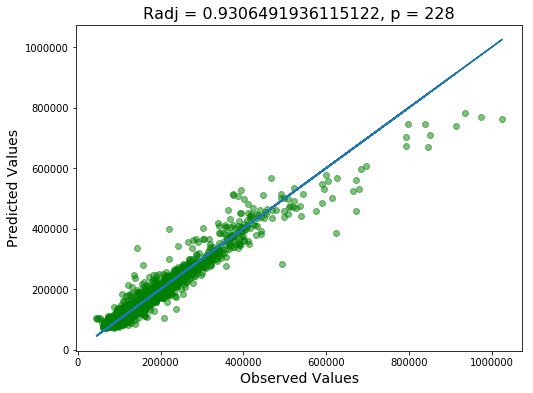

In [420]:
rf = RandomForestRegressor(random_state =42,
                                                n_estimators = 100,
                                                min_samples_leaf = 1,
                                                min_samples_split = 10,
                                                max_depth = 10,
                                                max_leaf_nodes = None)
rf.fit(train[corr_feats], train[output])
print ('Random Forest Model on Features Correlated with Output', '\n')
Radj, mae = mdl_eval(rf, output, corr_feats, val, train, 'green')
mdl_res.append(('Random Forest Regressor', 'Correlation', len(corr_feats), 'val', Radj, mae))

Radj, mae = mdl_eval(rf, output, corr_feats, test1, train, 'green', show=False)
mdl_res.append(('Random Forest Regressor', 'Correlation', len(corr_feats), '2015', Radj, mae))
Radj, mae = mdl_eval(rf, output, corr_feats, test2, train, 'green', show=False)
mdl_res.append(('Random Forest Regressor', 'Correlation', len(corr_feats), '2016', Radj, mae))

** * ii. RF Features * **

Random Forest Model on Random Forest Selected Features 

In Sample RSquared:  0.979580064127
Out of sample R-Squared:  0.93418455611
Out of sample Adjusted R-Squared:  0.933288390675
Model Eval (Median Absolute Error):  9381.75791096


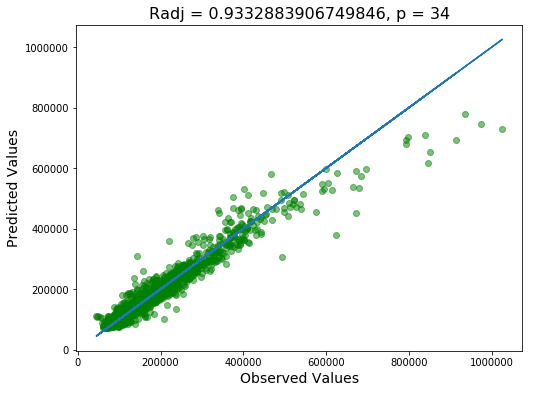

In [421]:
rf = RandomForestRegressor(random_state =42,
                                                n_estimators = 100,
                                                min_samples_leaf = 1,
                                                min_samples_split = 10,
                                                max_depth = 10,
                                                max_leaf_nodes = None)
rf.fit(train[rf_feats], train[output])
print ('Random Forest Model on Random Forest Selected Features', '\n')
Radj, mae = mdl_eval(rf, output, rf_feats, val, train, 'green')
mdl_res.append(('Random Forest Regressor', 'Random Forest', len(rf_feats), 'val', Radj, mae))

Radj, mae = mdl_eval(rf, output, rf_feats, test1, train, 'green', show=False)
mdl_res.append(('Random Forest Regressor', 'Random Forest', len(rf_feats), '2015', Radj, mae))
Radj, mae = mdl_eval(rf, output, rf_feats, test2, train, 'green', show=False)
mdl_res.append(('Random Forest Regressor', 'Random Forest', len(rf_feats), '2016', Radj, mae))

** * iii. LASSO Features * **

Random Forest Model on LASSO selected features 

In Sample RSquared:  0.979062787138
Out of sample R-Squared:  0.936609392472
Out of sample Adjusted R-Squared:  0.935409972764
Model Eval (Median Absolute Error):  8939.77976645


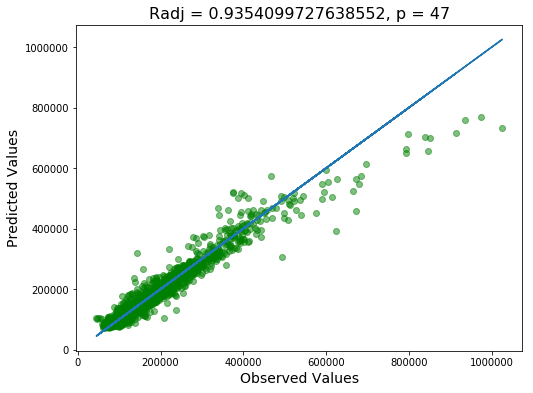

In [422]:
rf = RandomForestRegressor(random_state =42,
                                                n_estimators = 100,
                                                min_samples_leaf = 1,
                                                min_samples_split = 10,
                                                max_depth = 10,
                                                max_leaf_nodes = None)
rf.fit(train[las_feats], train[output])
print ('Random Forest Model on LASSO selected features', '\n')
Radj, mae = mdl_eval(rf, output, las_feats, val, train, 'green')
mdl_res.append(('Random Forest Regressor', 'LASSO', len(las_feats), 'val', Radj, mae))

Radj, mae = mdl_eval(rf, output, las_feats, test1, train, 'green', show=False)
mdl_res.append(('Random Forest Regressor', 'LASSO', len(las_feats), '2015', Radj, mae))
Radj, mae = mdl_eval(rf, output, las_feats, test2, train, 'green', show=False)
mdl_res.append(('Random Forest Regressor', 'LASSO', len(las_feats), '2016', Radj, mae))

### ** * c. Gradient Boosted Regressor * **

In [403]:
labels = ['n_estimators', 'min_samples_leaf', 'min_samples_split', 'max_depth', 'max_leaf_nodes', 'outRadj', 'MAE']
a =[(0, 0, 0, 0,0)]

starTime = time.time()
for e in n_estimators:
    for l in min_samples_leaf:
        for ss in min_samples_split:
            for d in max_depth:
                for no in max_leaf_nodes:
                    gb = GradientBoostingRegressor(random_state =42, loss='lad',
                                                n_estimators = e,
                                                min_samples_leaf = l,
                                                min_samples_split = ss,
                                                max_depth = d,
                                                max_leaf_nodes = no)
                    gb.fit(train[corr_feats], train[output])
                    r, mae = mdl_eval(gb, output, corr_feats, val, train, 'green', show=False)
                    a.append((e, l, ss, d, no, r, mae))
                    #print ('nest:{}, min_samp_lf:{}, min_sampspl:{}, max_d:{}, max_lfn:{}, AdjR:{}, MAE:{}'
                     #      .format(e, l, ss, d, no, r, mae))
print(time.time() - starTime)

k = pd.DataFrame.from_records(a, columns=labels)
k.loc[k.MAE.idxmin]

292.4545650482178


n_estimators          100.000000
min_samples_leaf       10.000000
min_samples_split       2.000000
max_depth              10.000000
max_leaf_nodes         20.000000
outRadj                 0.901857
MAE                  8486.033690
Name: 225, dtype: float64

** * i. Corr Features * **

Gradient Boosting on Correlated Featuers 

In Sample RSquared:  0.932277451833
Out of sample R-Squared:  0.910698437962
Out of sample Adjusted R-Squared:  0.901857466992
Model Eval (Median Absolute Error):  8486.03368956


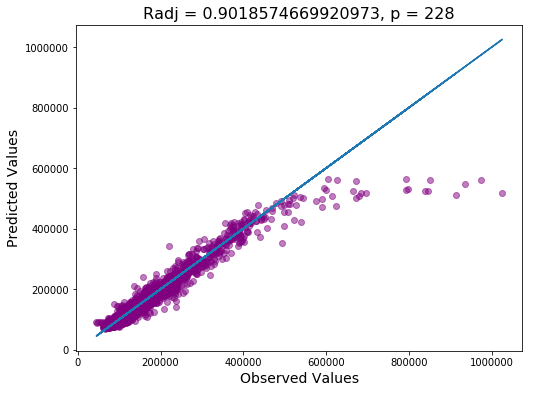

In [423]:
gb = GradientBoostingRegressor(random_state=42,loss='lad', n_estimators=100,
                               min_samples_leaf=10, max_depth=10,
                               min_samples_split=2, max_leaf_nodes=20)
gb.fit(train[corr_feats],train[output])
print ('Gradient Boosting on Correlated Featuers', '\n')
Radj, mae = mdl_eval(gb, output, corr_feats, val, train, 'purple')
mdl_res.append(('Gradient Booster Regressor', 'Correlation', len(corr_feats), 'val', Radj, mae))

Radj, mae = mdl_eval(gb, output, corr_feats, test1, train, 'green', show=False)
mdl_res.append(('Gradient Booster Regressor', 'Correlation', len(corr_feats), '2015', Radj, mae))
Radj, mae = mdl_eval(gb, output, corr_feats, test2, train, 'green', show=False)
mdl_res.append(('Gradient Booster Regressor', 'Correlation', len(corr_feats), '2016', Radj, mae))

** * ii. RF Features * **

Gradient Boosting on RF Selected Features 

In Sample RSquared:  0.944570989555
Out of sample R-Squared:  0.924213347804
Out of sample Adjusted R-Squared:  0.92318141101
Model Eval (Median Absolute Error):  9109.99709444


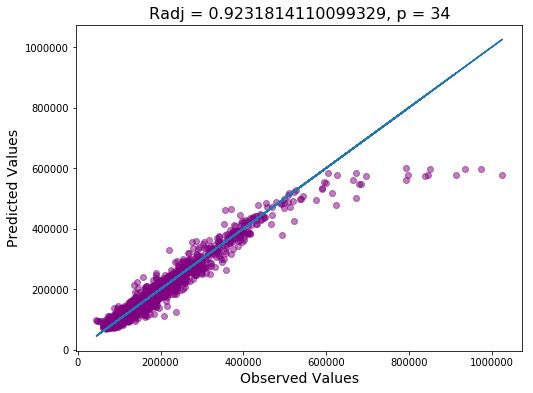

In [424]:
gb = GradientBoostingRegressor(random_state=42,loss='lad',n_estimators=100,
                               min_samples_leaf=10,max_depth=10,min_samples_split=2,
                               max_leaf_nodes=20)
gb.fit(train[rf_feats],train[output])
print ('Gradient Boosting on RF Selected Features', '\n')
Radj, mae = mdl_eval(gb, output, rf_feats, val, train, 'purple')
mdl_res.append(('Gradient Booster Regressor', 'Random Forest', len(rf_feats), 'val', Radj, mae))

Radj, mae = mdl_eval(gb, output, rf_feats, test1, train, 'green', show=False)
mdl_res.append(('Gradient Booster Regressor', 'Random Forest', len(rf_feats), '2015', Radj, mae))
Radj, mae = mdl_eval(gb, output, rf_feats, test2, train, 'green', show=False)
mdl_res.append(('Gradient Booster Regressor', 'Random Forest', len(rf_feats), '2016', Radj, mae))

** * iii. LASSO Features * **

Gradient Boosting on LASSO Selected Features 

In Sample RSquared:  0.946329766181
Out of sample R-Squared:  0.929792291202
Out of sample Adjusted R-Squared:  0.928463884473
Model Eval (Median Absolute Error):  8556.82039424


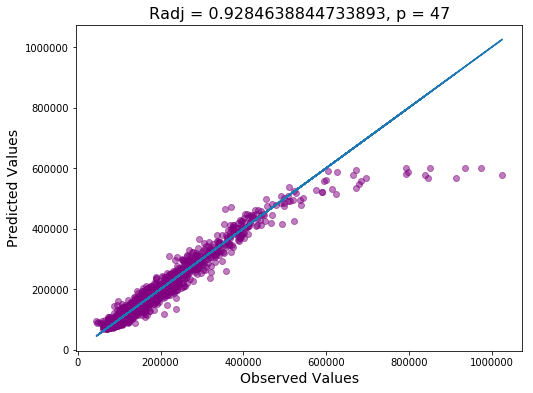

In [425]:
gb = GradientBoostingRegressor(random_state=42,loss='lad',n_estimators=100,
                               min_samples_leaf=10,max_depth=10,min_samples_split=2,
                               max_leaf_nodes=20)
gb.fit(train[las_feats],train[output])
print ('Gradient Boosting on LASSO Selected Features', '\n')
Radj, mae = mdl_eval(gb, output, las_feats, val, train, 'purple')
mdl_res.append(('Gradient Booster Regressor', 'LASSO', len(las_feats), 'val', Radj, mae))

Radj, mae = mdl_eval(gb, output, las_feats, test1, train, 'green', show=False)
mdl_res.append(('Gradient Booster Regressor', 'LASSO', len(las_feats), '2015', Radj, mae))
Radj, mae = mdl_eval(gb, output, las_feats, test2, train, 'green', show=False)
mdl_res.append(('Gradient Booster Regressor', 'LASSO', len(las_feats), '2016', Radj, mae))

### ** * d. elastic net * **

In [99]:
#testing paramters
alphas = [0.001,0.01,0.1,0.5,1,10,100,10000]
l1_ratios = [0,0.2,0.3,0.5,0.7,0.8,1]

starTime = time.time()

labels = ['alphas', 'l1_ratios', 'OutRAdj', 'MAE']
a =[(0, 0, 0, 0)]

for al in alphas:
    for l in l1_ratios:
        en = ElasticNet(random_state=0,normalize=True,alpha=al,l1_ratio=l,max_iter=10000)
        en.fit(train[corr_feats], train[output])
        r, mae = mdl_eval(en, output, corr_feats, val, train, 'green', show=False)
        a.append((al, l, r, mae))

print(time.time() - starTime)

k = pd.DataFrame.from_records(a, columns=labels)
k.drop(0, inplace=True)
k.loc[k.MAE.idxmin]

/Users/baileygriswold/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


76.25696396827698


alphas           0.010000
l1_ratios        1.000000
OutRAdj          0.966789
MAE          10039.164593
Name: 14, dtype: float64

** * i. Corr Features * **

/Users/baileygriswold/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Elastic net Model on Features Correlated with Output 

In Sample RSquared:  0.988161754862
Out of sample R-Squared:  0.935813477296
Out of sample Adjusted R-Squared:  0.929458927936
Model Eval (Median Absolute Error):  10143.4732591


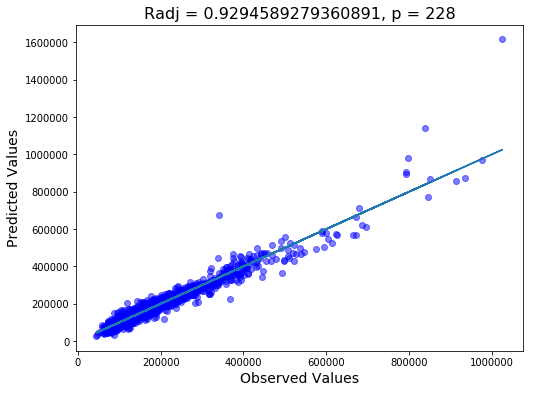

In [426]:
en = ElasticNet(random_state=0,normalize=True,alpha=0.01,l1_ratio=1,max_iter=10000)
en.fit(train[corr_feats], train[output])
print ('Elastic net Model on Features Correlated with Output', '\n')
Radj, mae = mdl_eval(en, output, corr_feats, val, train, 'blue')
mdl_res.append(('Elastic Net', 'Correlation', len(las_feats), 'val', Radj, mae))

Radj, mae = mdl_eval(en, output, corr_feats, test1, train, 'green', show=False)
mdl_res.append(('Elastic Net', 'Correlation', len(corr_feats), '2015', Radj, mae))
Radj, mae = mdl_eval(en, output, corr_feats, test2, train, 'green', show=False)
mdl_res.append(('Elastic Net', 'Correlation', len(corr_feats), '2016', Radj, mae))

** * ii. RF Features * **

Elastic net Model on Random Forest Selected Features 

In Sample RSquared:  0.971848995581
Out of sample R-Squared:  0.900146299153
Out of sample Adjusted R-Squared:  0.899061626364
Model Eval (Median Absolute Error):  10331.270492


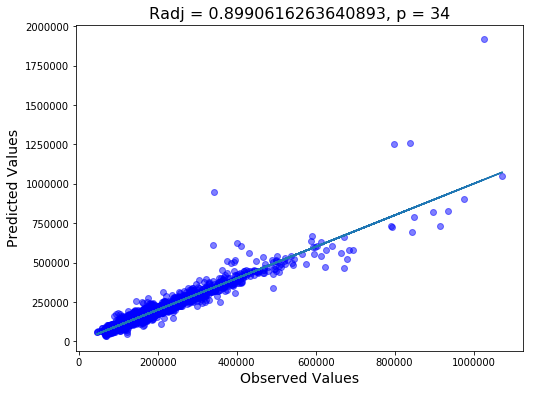

In [427]:
en = ElasticNet(random_state=0,normalize=True,alpha=.01,l1_ratio=1,max_iter=10000)
en.fit(train[rf_feats], train[output])
print ('Elastic net Model on Random Forest Selected Features', '\n')
Radj, mae = mdl_eval(en, output, rf_feats, test, train, 'blue')
mdl_res.append(('Elastic Net', 'Random Forest', len(rf_feats), 'val', Radj, mae))

Radj, mae = mdl_eval(en, output, rf_feats, test1, train, 'green', show=False)
mdl_res.append(('Elastic Net', 'Random Forest', len(rf_feats), '2015', Radj, mae))
Radj, mae = mdl_eval(en, output, rf_feats, test2, train, 'green', show=False)
mdl_res.append(('Elastic Net', 'Random Forest', len(rf_feats), '2016', Radj, mae))

** * iii. LASSO Features * **

Elastic net Model on LASSO Selected Feature 

In Sample RSquared:  0.976460477733
Out of sample R-Squared:  0.897124472115
Out of sample Adjusted R-Squared:  0.895573253055
Model Eval (Median Absolute Error):  10078.7908633


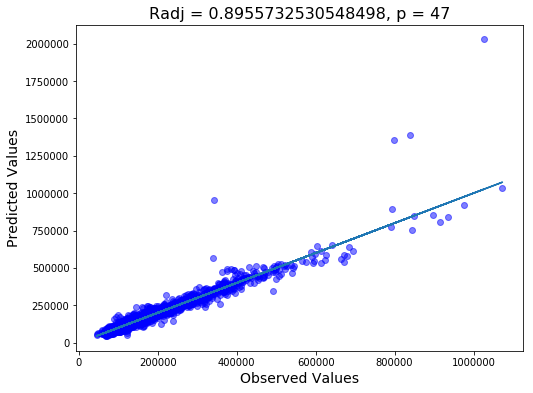

In [428]:
en = ElasticNet(random_state=0,normalize=True,alpha=0.01,l1_ratio=1,max_iter=10000)
en.fit(train[las_feats], train[output])
print ('Elastic net Model on LASSO Selected Feature', '\n')
Radj, mae = mdl_eval(en, output, las_feats, test, train, 'blue')
mdl_res.append(('Elastic Net', 'LASSO', len(las_feats), 'val', Radj, mae))

Radj, mae = mdl_eval(en, output, las_feats, test1, train, 'green', show=False)
mdl_res.append(('Elastic Net', 'LASSO', len(las_feats), '2015', Radj, mae))
Radj, mae = mdl_eval(en, output, las_feats, test2, train, 'green', show=False)
mdl_res.append(('Elastic Net', 'LASSO', len(las_feats), '2016', Radj, mae))

## 7. Comparing Model Performance

In [453]:
#res = pd.DataFrame.from_records(mdl_res, columns=res_labels)
#res.drop(0, inplace=True)
res.head(5)

,Model,Feature_sel,N_Features,Out_of_sample_data,R_Adj,MAE
1,OLS,Baseline,1383.0,val,-1.272531,26514.835516
2,OLS,Baseline,1383.0,2015,-0.434520,18786.541853
3,OLS,Baseline,1383.0,2016,-0.434520,18786.541853
4,OLS,Correlation,228.0,val,0.925820,10704.681280
5,OLS,Correlation,1383.0,2015,0.940421,9762.636833


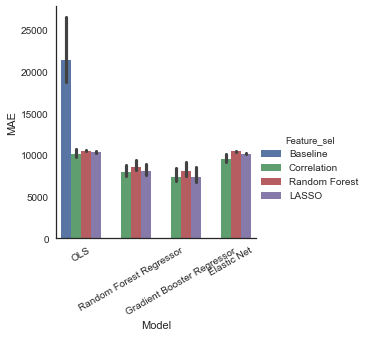

In [458]:

sns.set(font_scale=1)
with sns.axes_style("white"):
    b = sns.factorplot('Model', 'MAE', data=res, hue='Feature_sel',kind='bar')
b.set_xticklabels(rotation=30)